In [1]:
import scanpy as sc
import scvelo as scv
import anndata
import pandas as pd
import cellrank as cr
import numpy as np
import scachepy

np.random.seed(42)

scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo', frameon=True)
cr.settings.verbosity = 2

In [2]:
print("# Loading from 'create_caches.py'")
adata_w_velo = scv.read("./data/epi_data_w_velo.h5ad")


# Loading from 'create_caches.py'


Cytovelo output has all of the cells, not just the ones in the epi that passed QC.


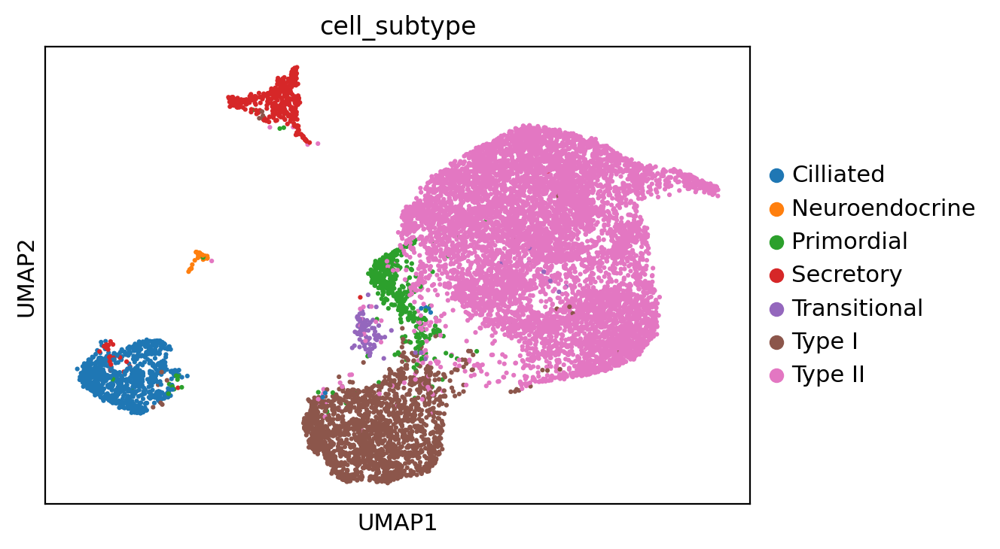

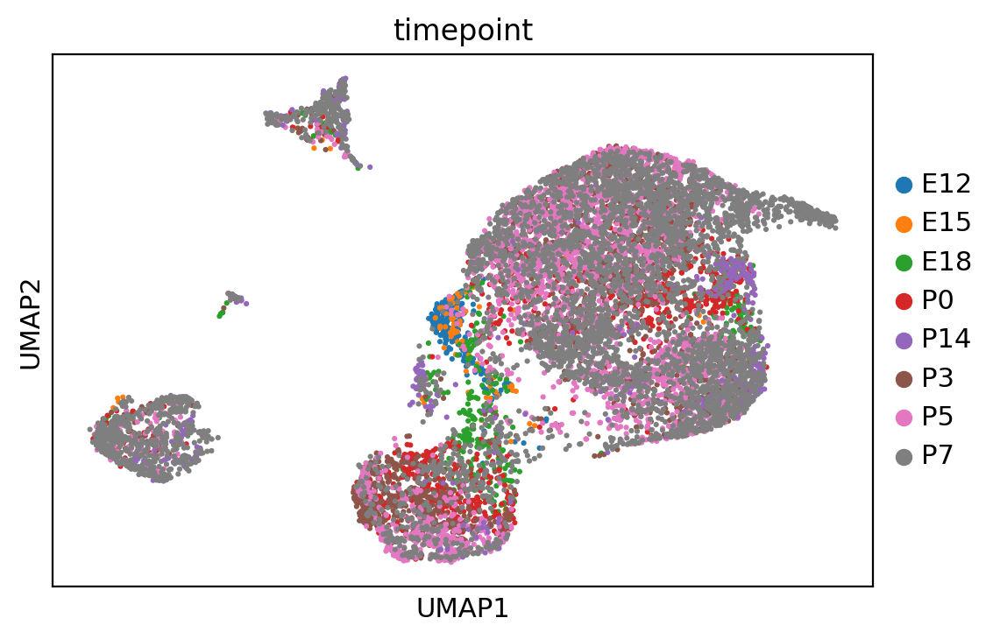

In [3]:
sc.pl.umap(adata_w_velo, color = 'cell_subtype', size = 20)
sc.pl.umap(adata_w_velo, color = 'timepoint', size = 20)

## Run scVelo

Starting partway through the tutorial - normalization and PCA and UMAP is already done.

In [4]:
adata_w_velo

AnnData object with n_obs × n_vars = 11472 × 19455
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size'
    uns: 'cell_subtype_colors', 'timepoint_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [5]:
# must use the same settings as in 'create_caches.py'
scv.pp.moments(adata_w_velo, n_pcs=25, n_neighbors=25)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:21) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:20) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [6]:
c = scachepy.Cache('./cache/cellrank')
c.tl.recover_dynamics(adata_w_velo) # scv

Loading data from: `recover_dynamics.pickle`.


In [7]:
c.tl.velocity(adata_w_velo, mode='dynamical') # svc
c.tl.velocity_graph(adata_w_velo) # scv


Loading data from: `velo.pickle`.
`adata.var` already contains key: `'fit_beta'`.
`adata.var` already contains key: `'fit_gamma'`.
`adata.var` already contains key: `'velocity_genes'`.
Loading data from: `velo_graph.pickle`.
`adata.uns` already contains key: `'velocity_graph_neg'`.


computing velocity embedding
    finished (0:00:13) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


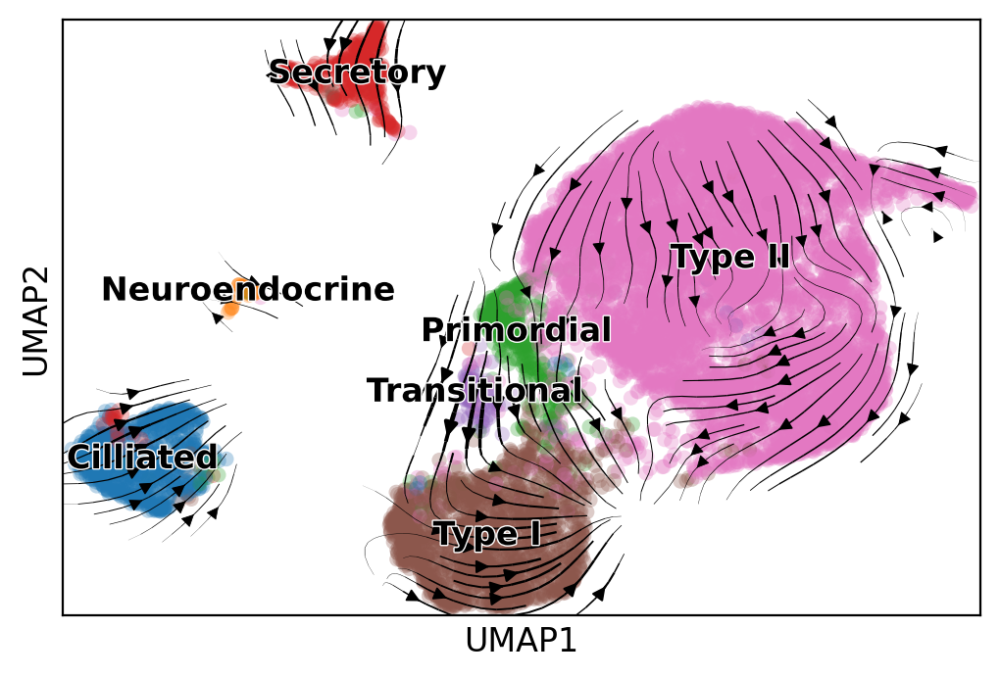

In [8]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype')


## SCV
More scvelo - figure out of the different clusters have different kintics.

In [9]:
adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:400]


Index(['Nme5', 'Ak7', 'Cfap53', 'Fhad1', '1700007G11Rik', 'Rtkn2', 'Sparc',
       'Gm867', 'Ccdc30', 'Mlf1',
       ...
       'Txlng', 'Tcp11', 'H2-Q6', 'Wif1', 'Gm16188', '2410004P03Rik',
       'Plekha1', 'Ccdc60', 'Ruvbl2', 'Clic6'],
      dtype='object', length=400)

In [10]:
top_genes = adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:200]
scv.tl.differential_kinetic_test(adata_w_velo, var_names=top_genes, groupby='cell_subtype')


testing for differential kinetics
    finished (0:02:16) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


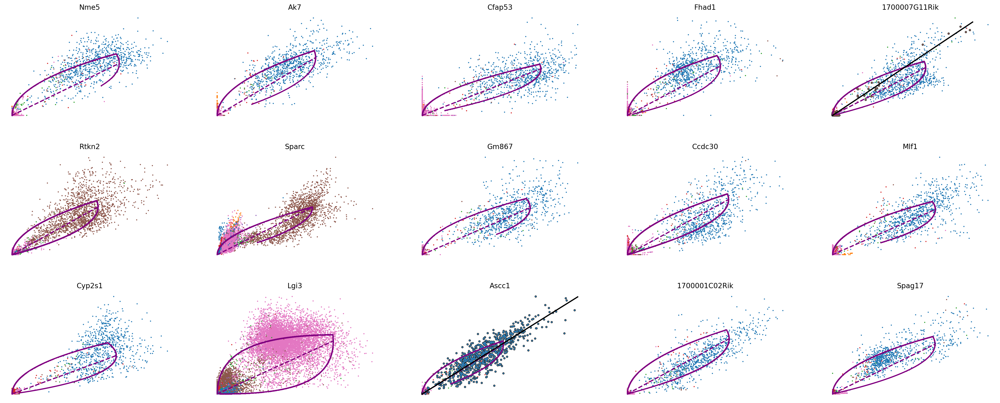

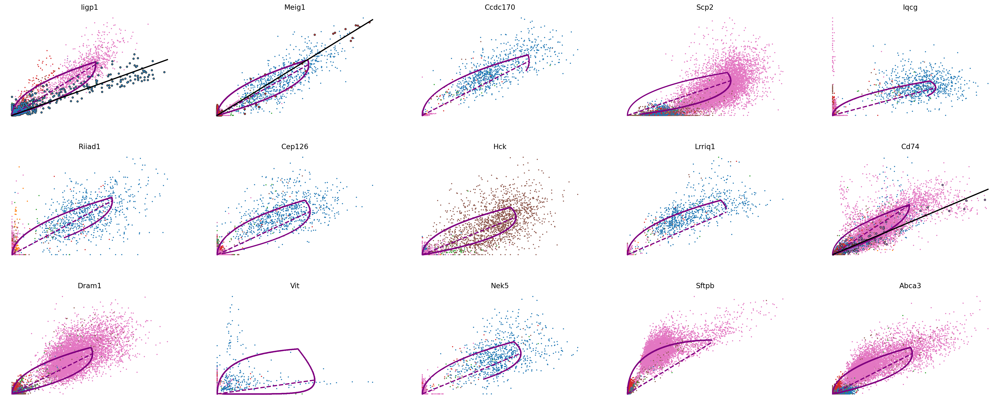

In [11]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(adata_w_velo, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

scv.pl.scatter(adata_w_velo, basis=top_genes[15:30], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

In [12]:
scv.tl.velocity(adata_w_velo, diff_kinetics=True, mode='dynamical')
scv.tl.velocity_graph(adata_w_velo)


computing velocities
    finished (0:01:49) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:03:49) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [13]:
adata_w_velo.obs['cell_subtype'].cat.categories
# Cilliated
# Neuro
# Primordial
# Secretory
# Transitional
# T2
# T1
adata_w_velo.uns['cell_subtype_colors'] = ["#2ca02c", # Dark green
                                           "#d62728", # Red
                                           "#1f77b4", # Dark blue
                                           "#98df8a", # Light green
                                           "#aec7e8", # Light blue
                                           "#ff7f0e", # Dark orange
                                           "#ffbb78", # Light orange
                                          ] 

computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_velocity.png


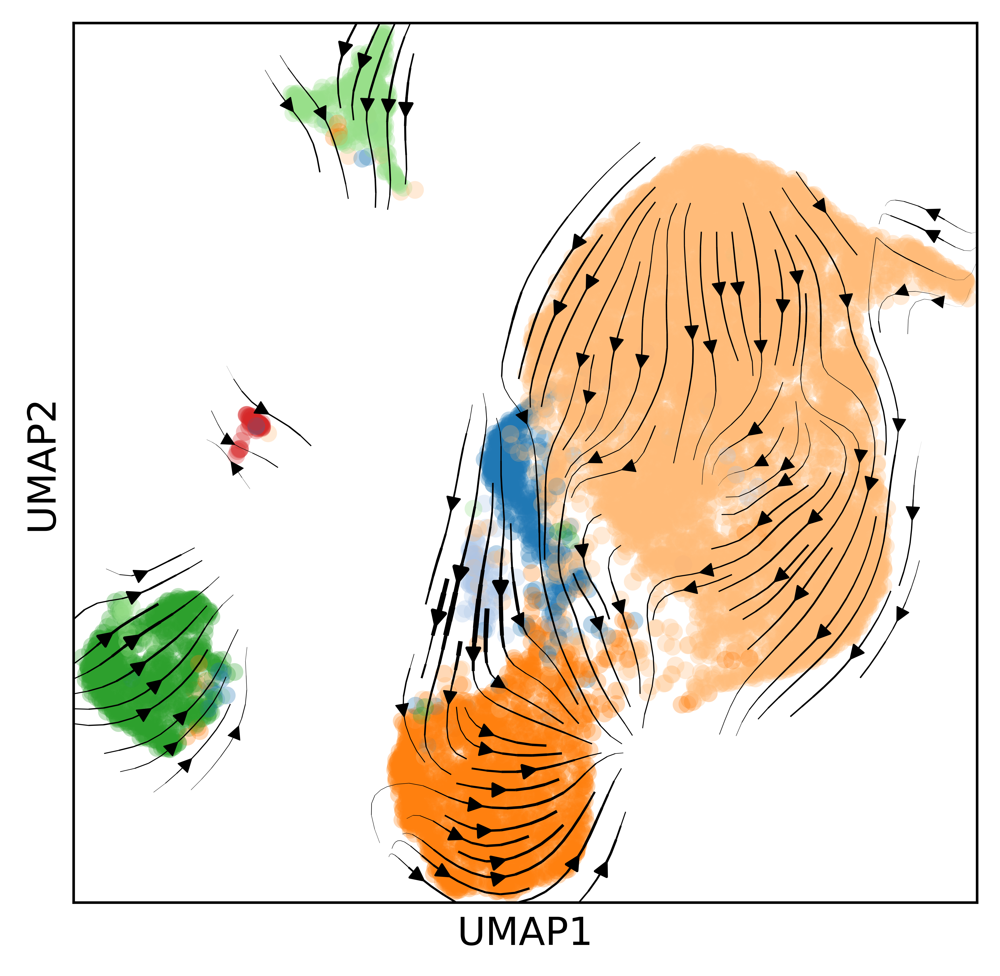

In [14]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype',
                                 figsize = (5,5),
                                 save = "velocity.png",
                                 dpi = 600,
                                 legend_loc = 'none')



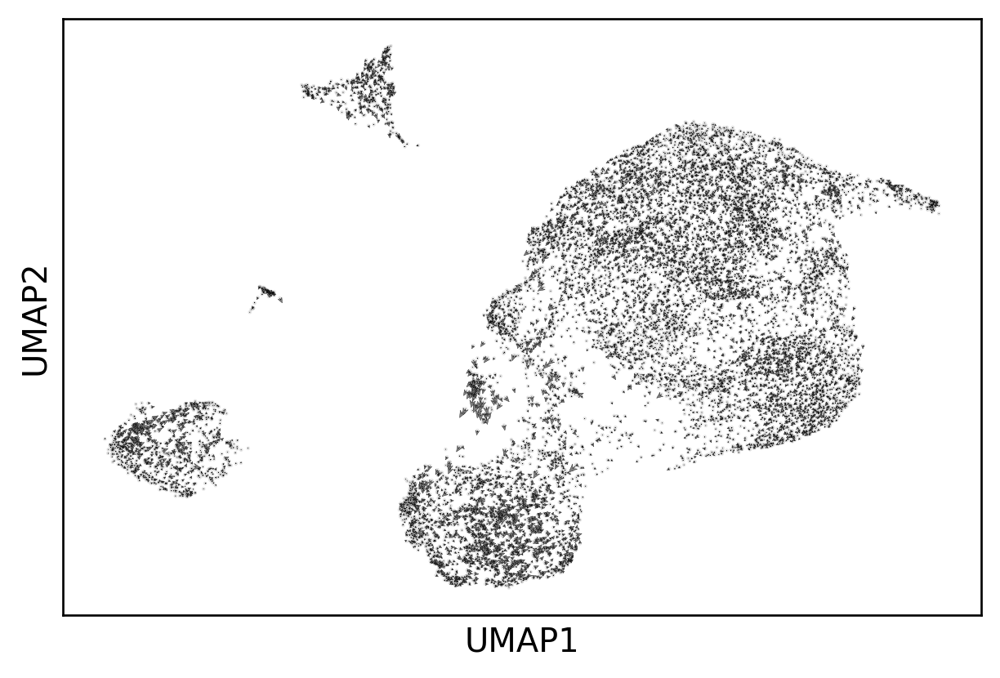

In [15]:
scv.pl.velocity_embedding(adata_w_velo, dpi=120, arrow_size=2, arrow_length=2)

In [16]:
scv.tl.velocity_embedding(adata_w_velo, autoscale = False)

computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


In [17]:
scv.tl.velocity_confidence(adata_w_velo)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


ranking velocity genes
    finished (0:01:20) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


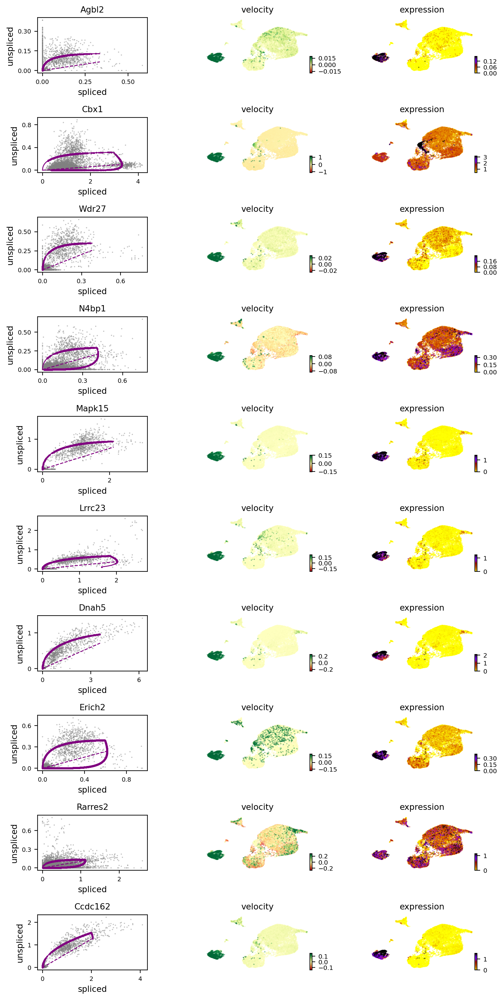

In [18]:
scv.pl.velocity(adata_w_velo, var_names="Hopx", groupby = "cell_subtype")

In [19]:
import matplotlib as mpl
mpl.rcParams['image.cmap']

'RdBu_r'

## Start cellrank part

Identify terminal states

Play with estimators.


In [20]:
from cellrank.tl.kernels import VelocityKernel
from cellrank.tl.kernels import ConnectivityKernel

vk = VelocityKernel(adata_w_velo).compute_transition_matrix(seed = 42)
ck = ConnectivityKernel(adata_w_velo).compute_transition_matrix()


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=10.4868`



    Finish (0:01:53)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [21]:
combined_kernel = 0.8 * vk + 0.2 * ck
print(combined_kernel)

((0.8 * <Velo[softmax_scale=10.49, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.2 * <Conn[dnorm=True]>))


In [22]:
from cellrank.tl.estimators import GPCCA
g = GPCCA(combined_kernel)
print(g)

GPCCA[n=11472, kernel=((0.8 * <Velo[softmax_scale=10.49, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.2 * <Conn[dnorm=True]>))]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[18, 26, 34, 37, 42, 46, 48, 52, 57, 60, 62, 64, 67, 69, 71, 73, 75, 77, 79, 82, 85, 87, 89]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:09)


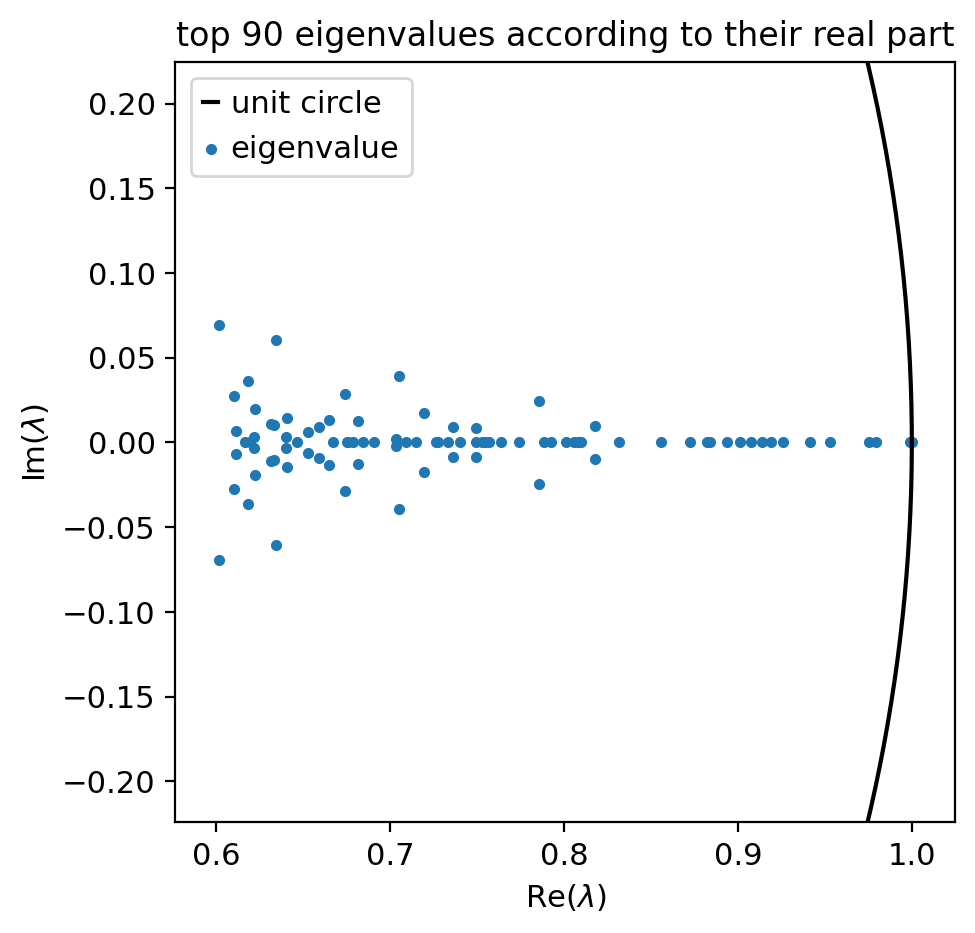

In [23]:
g.compute_schur(n_components=90)
g.plot_spectrum()

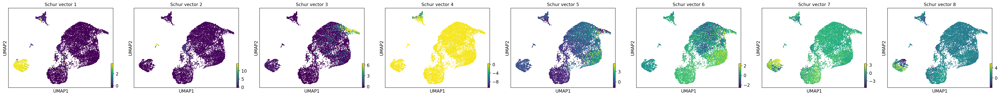

In [24]:
g.plot_schur(use=8)

Computing `9` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:23)


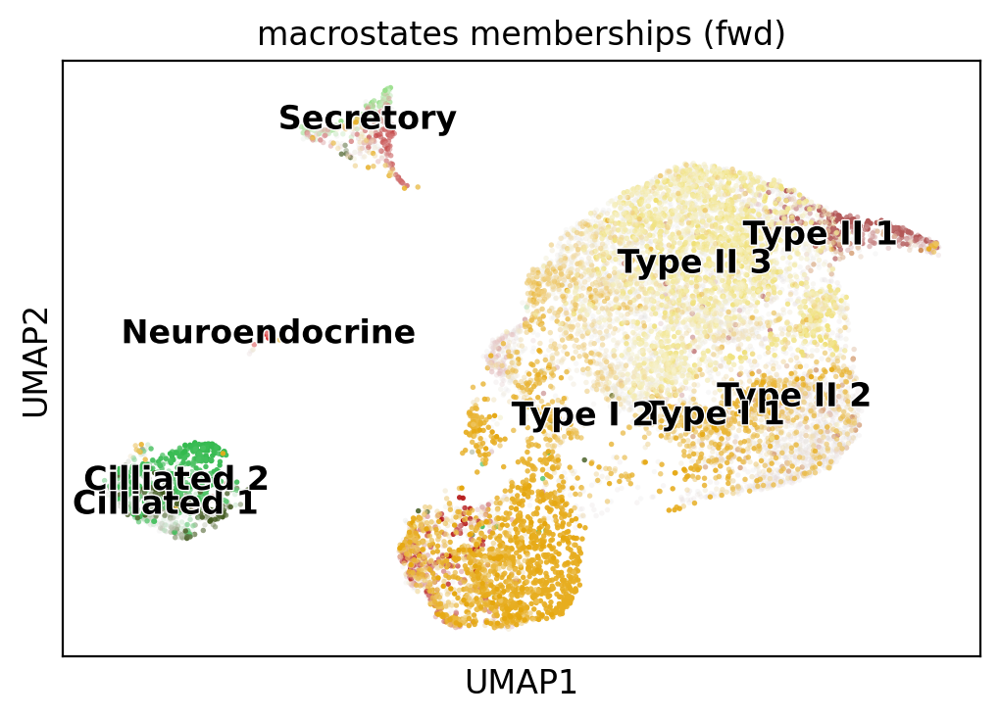

In [25]:
g.compute_macrostates(n_states=9, cluster_key='cell_subtype')
g.plot_macrostates()

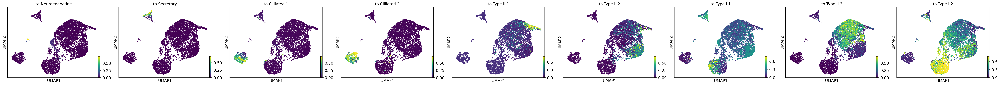

In [26]:
g.plot_macrostates(same_plot=False)

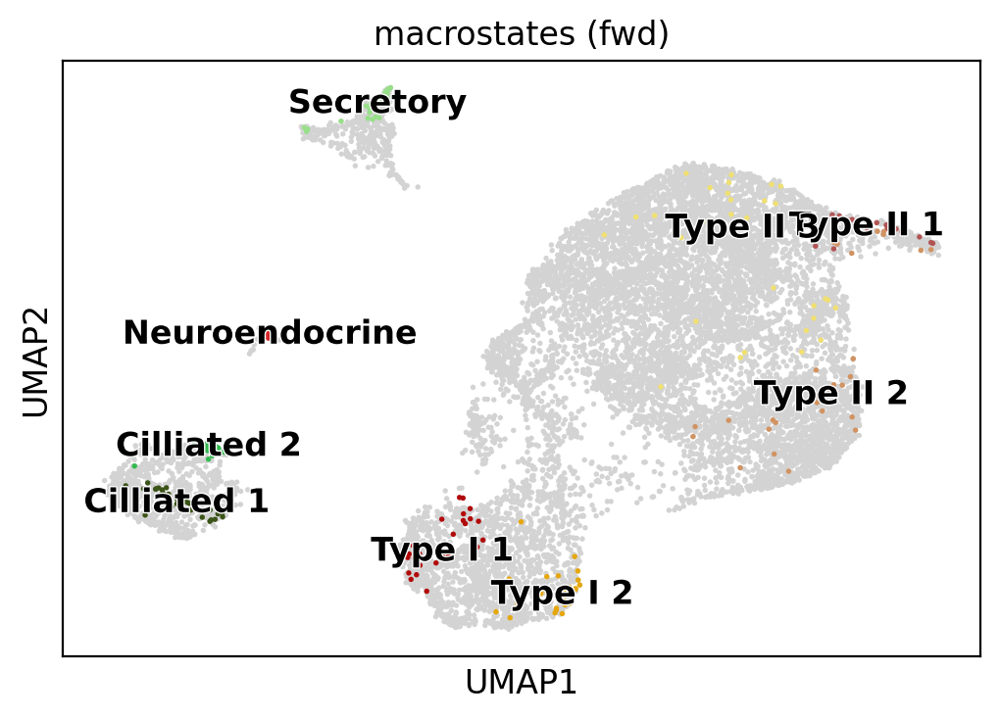

In [27]:
g.plot_macrostates(discrete=True)


In [28]:
g.set_terminal_states_from_macrostates()

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


In [29]:
g.compute_absorption_probabilities(n_jobs = 10)

Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:18)


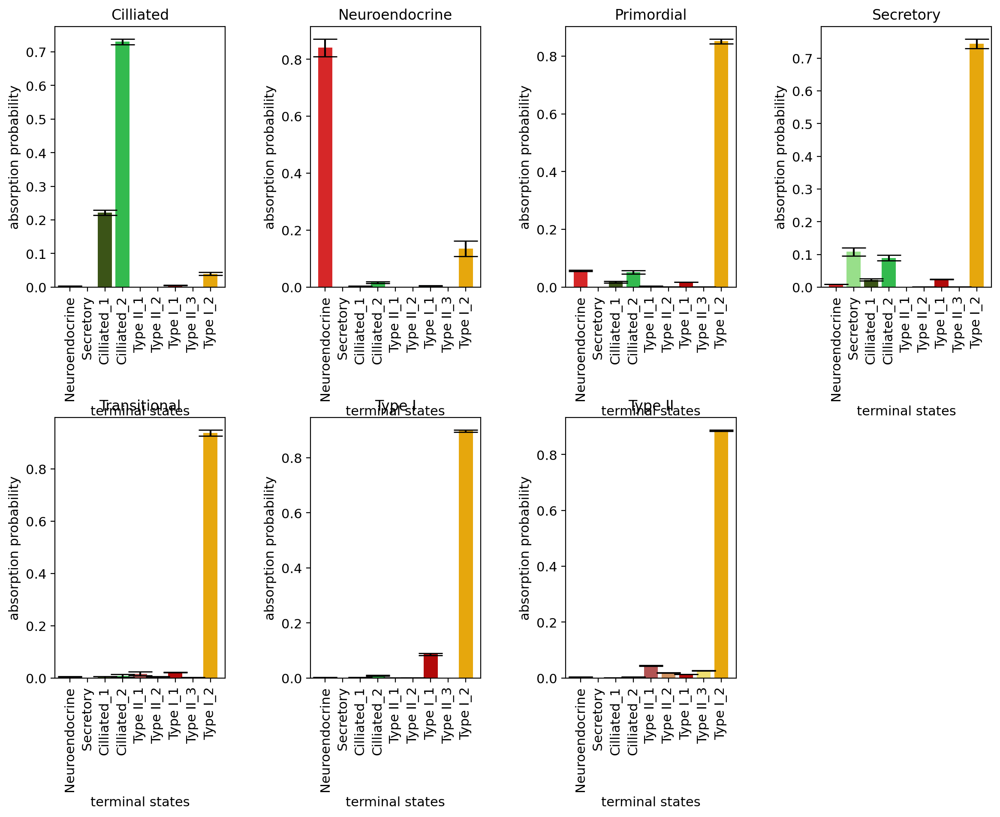

In [30]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = False)

Computing lineage probabilities towards terminal states
Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:17)
Adding lineages to `adata.obsm['to_terminal_states']`
    Finish (0:00:17)


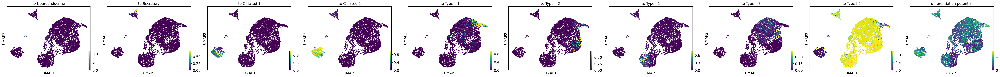

In [31]:
cr.tl.lineages(adata_w_velo)
cr.pl.lineages(adata_w_velo, same_plot=False)

## Now, for finding initial states (run backwards)

In [32]:
vk_b = VelocityKernel(adata_w_velo, backward = True).compute_transition_matrix(seed = 42)
ck_b = ConnectivityKernel(adata_w_velo, backward = True).compute_transition_matrix()

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=10.4868`



    Finish (0:03:07)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [33]:
combined_kernel_b = 0.6 * vk_b + 0.4 * ck_b

In [34]:
g_b = GPCCA(combined_kernel_b)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[10, 16, 19, 28, 30, 35, 39, 45, 48, 51, 55, 59, 61, 63, 67, 69, 73, 76, 78, 81, 83, 85, 87, 89, 92, 94, 96, 98, 101, 106, 108, 111, 113, 115, 117, 120]`
Adding `.eigendecomposition`
       `adata.uns['eig_bwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:10)


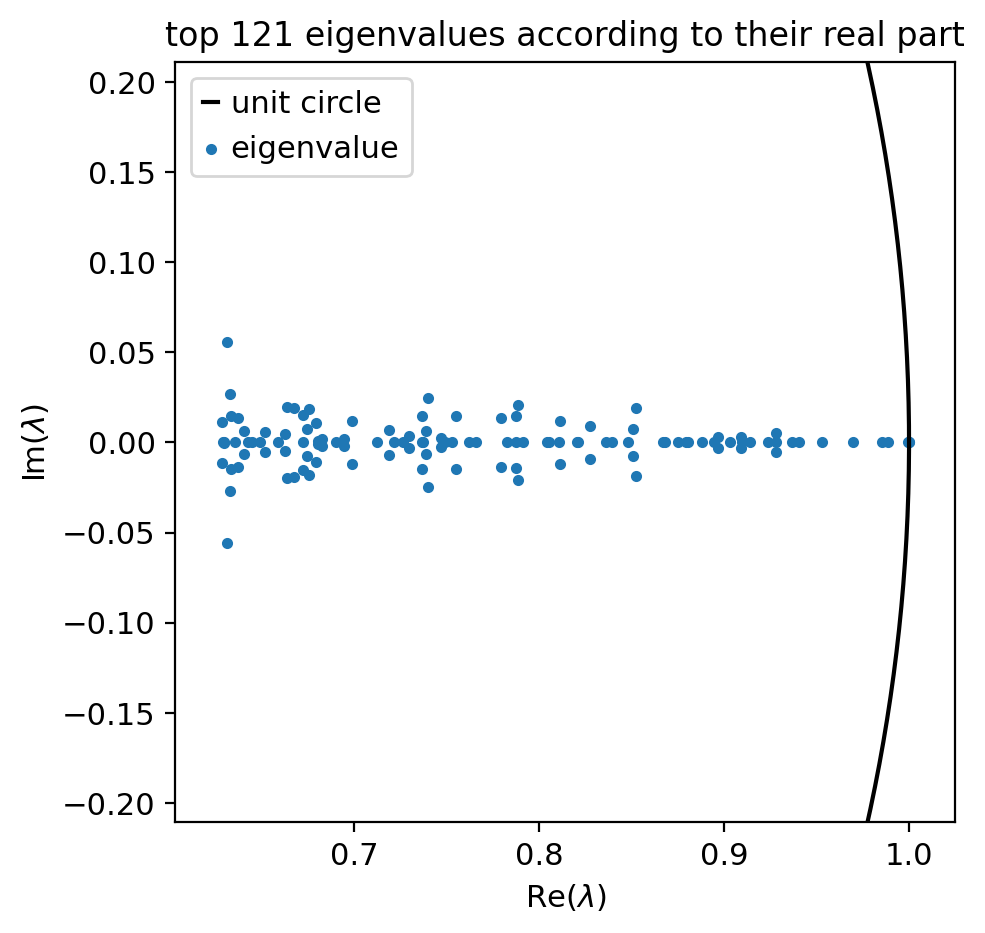

In [35]:
g_b.compute_schur(n_components=120)
g_b.plot_spectrum()

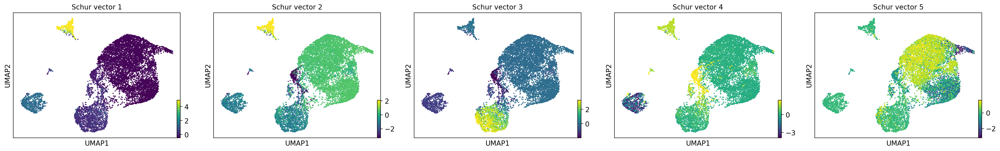

In [36]:
g_b.plot_schur(use=5)

Computing `7` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:14)


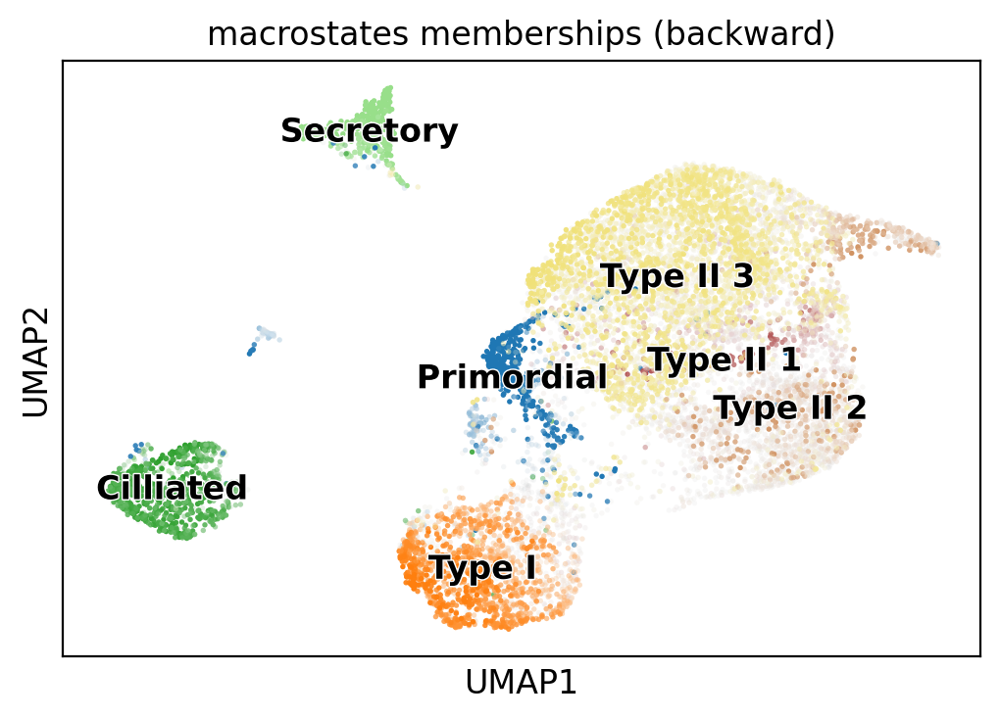

In [37]:
g_b.compute_macrostates(n_states=7, cluster_key='cell_subtype')
g_b.plot_macrostates()

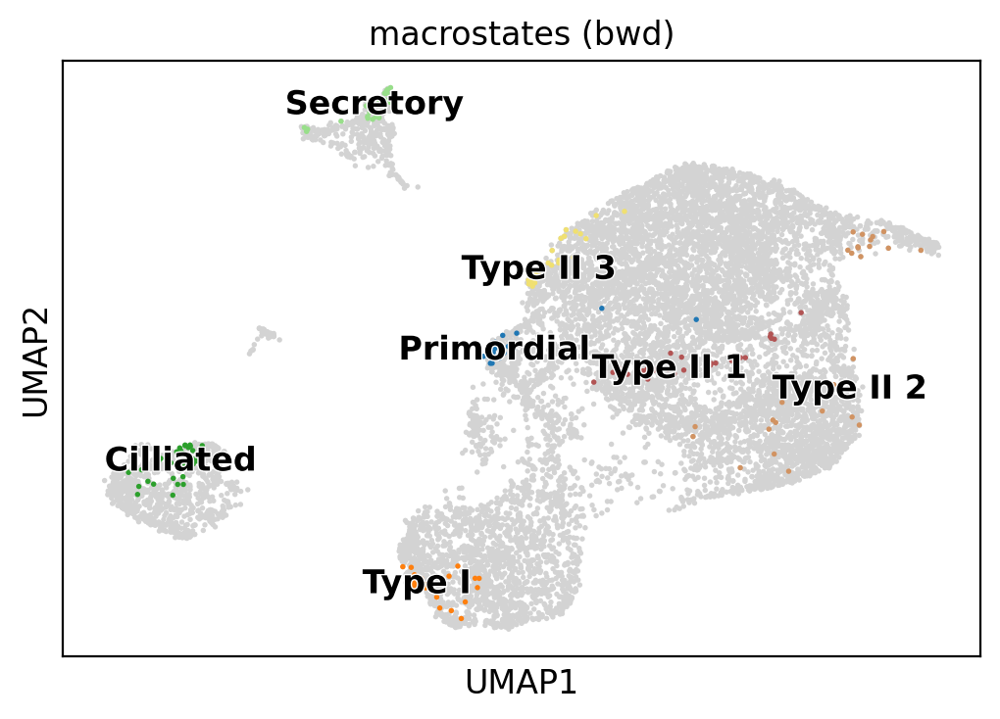

In [38]:
g_b.plot_macrostates(discrete = True)

In [39]:
g_b.set_terminal_states_from_macrostates()
g_b.compute_absorption_probabilities(n_jobs = 10)

Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`
       `adata.obsm['macrostates_bwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
Computing absorption probabilities
Adding `adata.obsm['from_initial_states']`
       `adata.obs['from_initial_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:17)


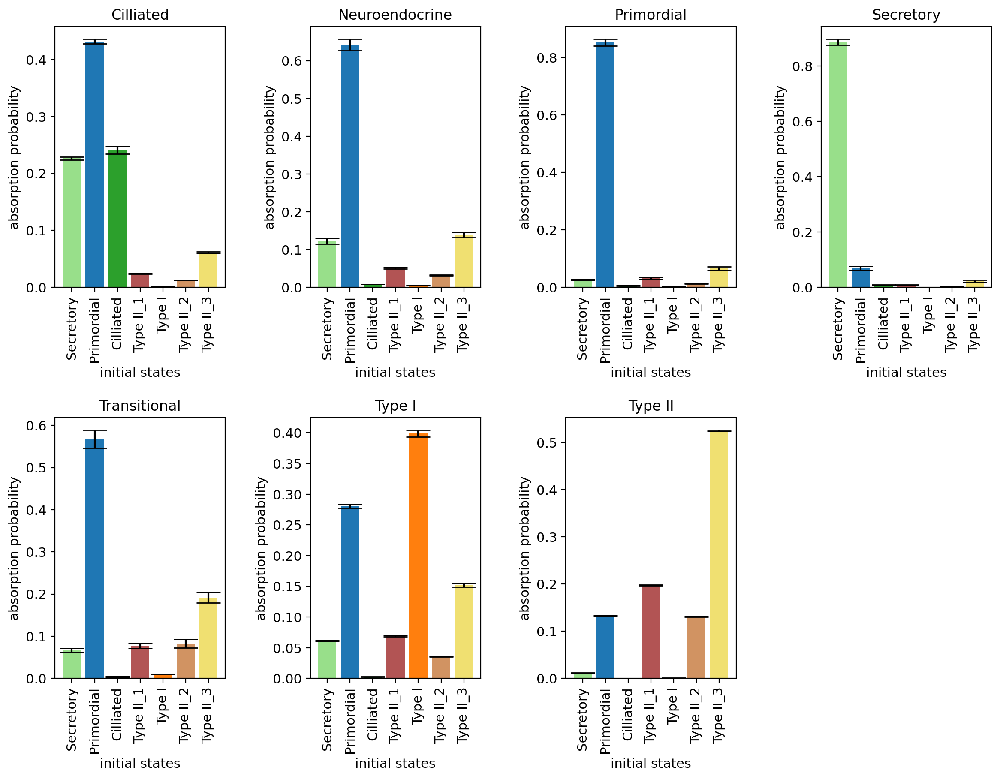

In [40]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = True)

In [41]:
scv.tl.recover_latent_time(
    adata_w_velo, root_key="initial_states_probs", end_key="terminal_states_probs"
)

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:39) --> added 
    'latent_time', shared time (adata.obs)


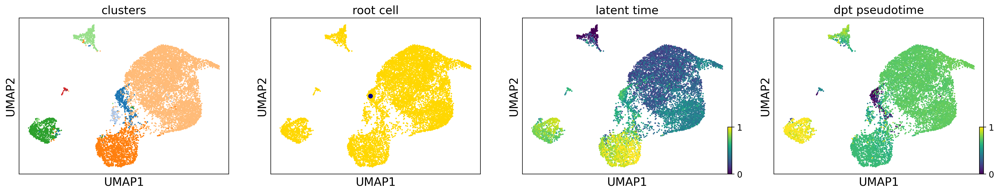

In [42]:
# compue dpt, starting from CellRank defined root cell
root_idx = np.where(adata_w_velo.obs['initial_states'] == 'Primordial')[0][0]
adata_w_velo.uns['iroot'] = root_idx
sc.tl.dpt(adata_w_velo)

scv.pl.scatter(adata_w_velo, color=['cell_subtype', root_idx, 'latent_time', 'dpt_pseudotime'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['clusters', 'root cell', 'latent time', 'dpt pseudotime'])

In [43]:
scv.tl.paga(
    adata_w_velo,
    groups="cell_subtype",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:10) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


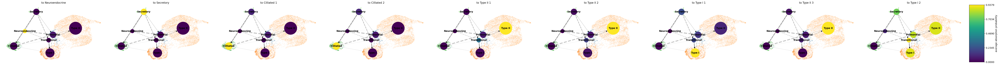

In [44]:
cr.pl.cluster_fates(
    adata_w_velo,
    mode="paga",
    cluster_key="cell_subtype",
    basis="umap",
    legend_kwargs={"loc": "bottom right"},
    legend_loc="on data",
    node_size_scale=5,
    edge_width_scale=1,
    max_edge_width=4,
    title="directed PAGA",
)

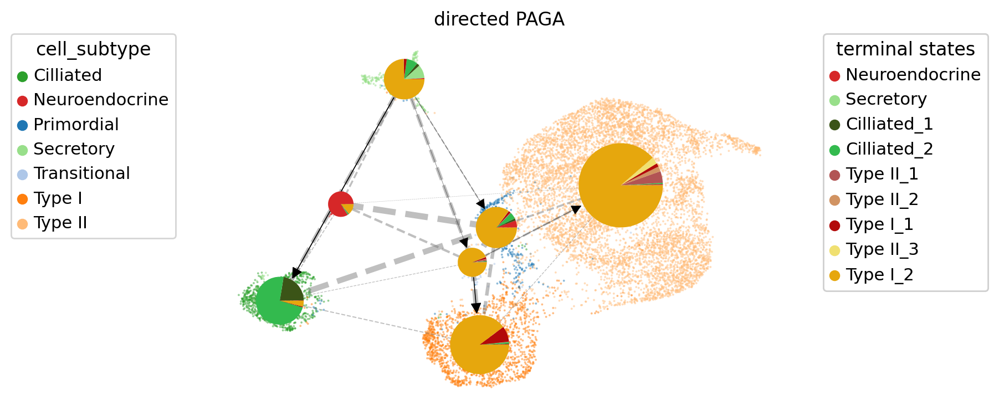

In [45]:
cr.pl.cluster_fates(adata_w_velo, mode="paga_pie", cluster_key="cell_subtype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

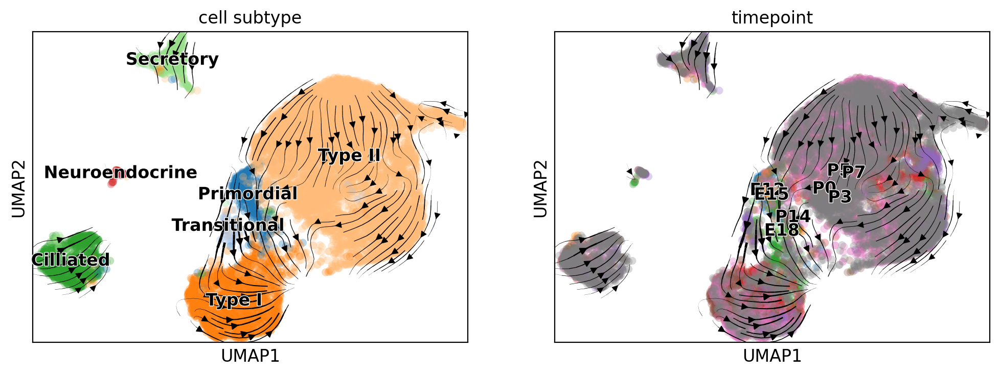

In [46]:
scv.pl.velocity_embedding_stream(adata_w_velo, basis='umap', color=['cell_subtype', 'timepoint'])


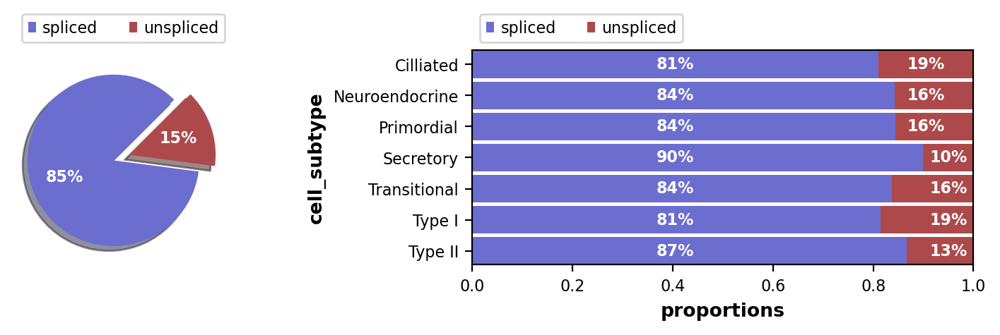

In [47]:
scv.pl.proportions(adata_w_velo, groupby = "cell_subtype")

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


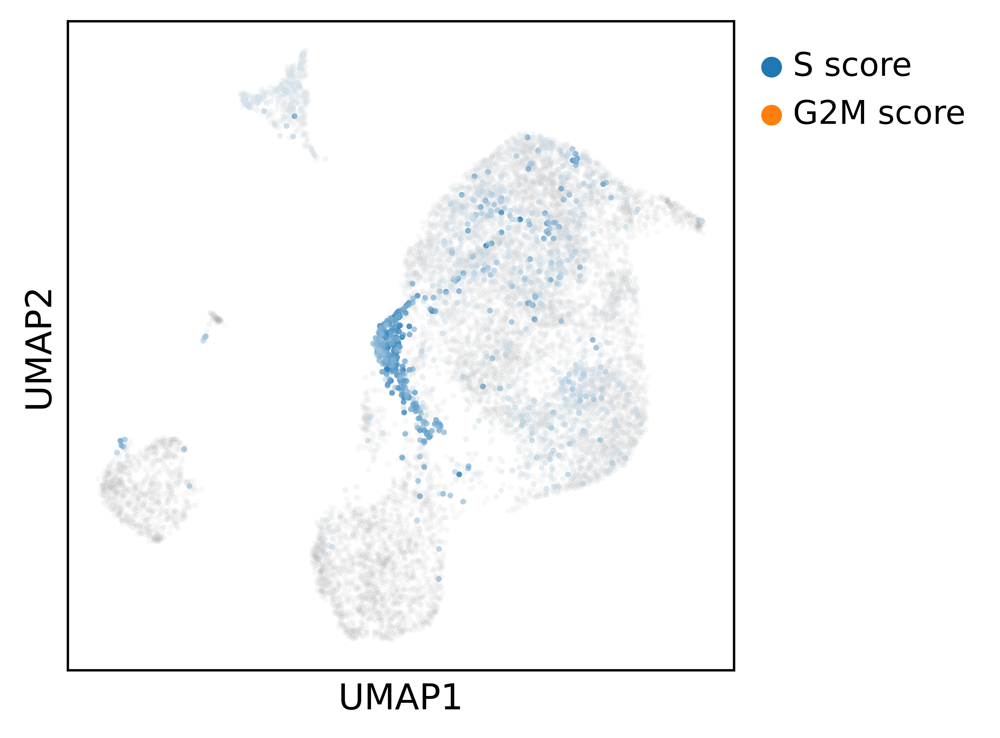

In [48]:
scv.tl.score_genes_cell_cycle(adata_w_velo)
scv.pl.scatter(adata_w_velo, color_gradients=['S_score', 'G2M_score'],
               smooth=True, perc=[5, 95], palette='PuGn',
               figsize = (4,4),
               dpi = 600)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)


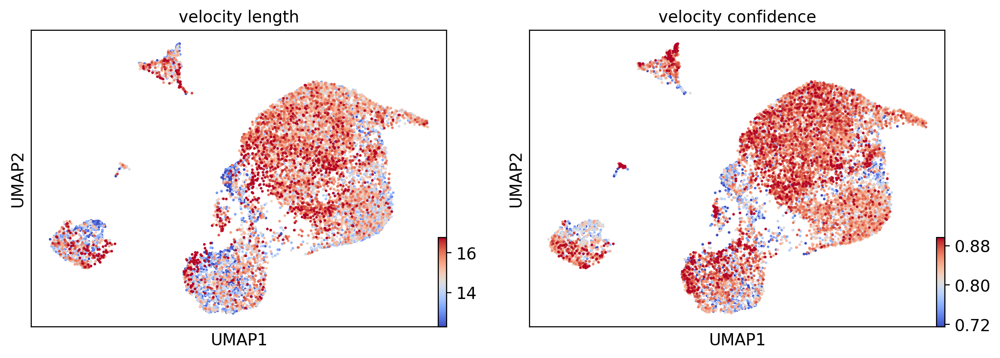

In [49]:
scv.tl.velocity_confidence(adata_w_velo)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(adata_w_velo, c=keys, cmap='coolwarm', perc=[5, 95])

computing terminal states
    identified 0 region of root cells and 2 regions of end points .
    finished (0:00:02) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


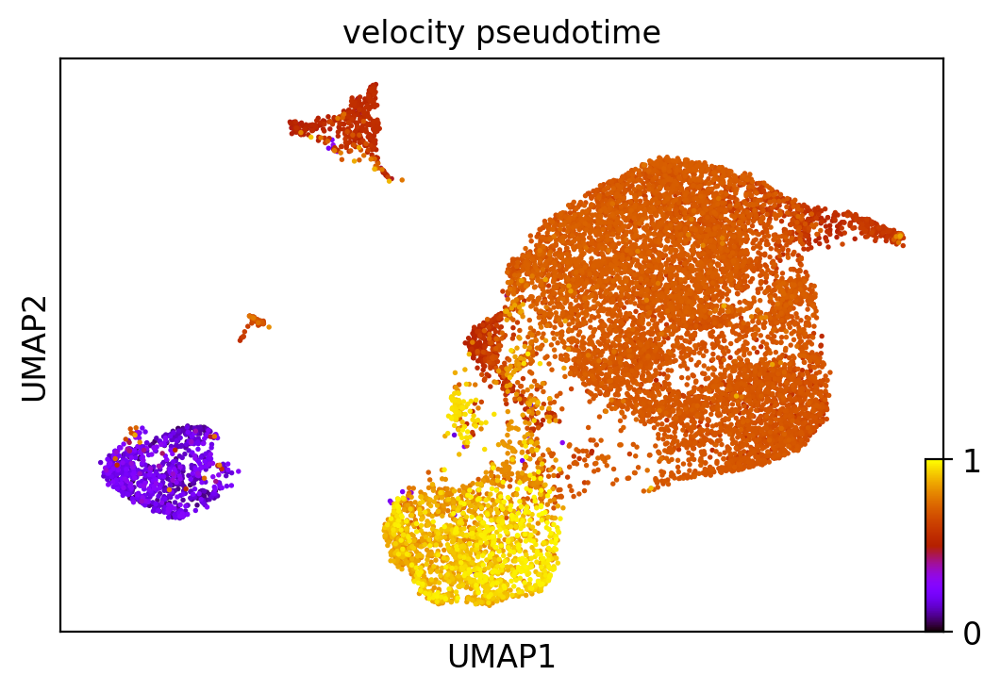

In [50]:
scv.tl.velocity_pseudotime(adata_w_velo)
scv.pl.scatter(adata_w_velo, color='velocity_pseudotime', cmap='gnuplot')

In [51]:
list(adata_w_velo.uns['to_terminal_states_names'])

['Neuroendocrine',
 'Secretory',
 'Cilliated_1',
 'Cilliated_2',
 'Type II_1',
 'Type II_2',
 'Type I_1',
 'Type II_3',
 'Type I_2']

In [52]:
adata_w_velo.uns.keys()

odict_keys(['cell_subtype_colors', 'timepoint_colors', 'pca', 'neighbors', 'recover_dynamics', 'velocity_graph', 'velocity_graph_neg', 'velocity_params', 'rank_velocity_genes', 'T_fwd_params', 'eig_fwd', 'clusters_gradients_colors', 'terminal_states_colors', 'terminal_states_names', 'to_terminal_states_names', 'to_terminal_states_colors', 'T_bwd_params', 'eig_bwd', 'initial_states_colors', 'initial_states_names', 'from_initial_states_names', 'from_initial_states_colors', 'iroot', 'diffmap_evals', 'paga', 'cell_subtype_sizes'])

In [53]:
adata_lite = anndata.AnnData(X=None,
                obs = adata_w_velo.obs,
                var = adata_w_velo.var,
                uns = adata_w_velo.uns,
                obsm = adata_w_velo.obsm,
                varm = adata_w_velo.varm)

In [54]:
keys = ['to_terminal_states_names', 'from_initial_states_names', 'initial_states_names']
out_dict = {}
for key in keys:
    out_dict[key] = adata_lite.uns[key]
    
print(out_dict)

{'to_terminal_states_names': array(['Neuroendocrine', 'Secretory', 'Cilliated_1', 'Cilliated_2',
       'Type II_1', 'Type II_2', 'Type I_1', 'Type II_3', 'Type I_2'],
      dtype='<U14'), 'from_initial_states_names': array(['Secretory', 'Primordial', 'Cilliated', 'Type II_1', 'Type I',
       'Type II_2', 'Type II_3'], dtype='<U10'), 'initial_states_names': array(['Secretory', 'Primordial', 'Cilliated', 'Type II_1', 'Type I',
       'Type II_2', 'Type II_3'], dtype=object)}


In [55]:
adata_lite.uns = out_dict

In [56]:
adata_lite.write("./only_metadata.h5ad", compression = 'gzip')

In [57]:
## Print versions of all loaded modules
import sys

module_list = [f"{module.__name__} {module.__version__}" for module in sys.modules.values() if
                  hasattr(module, "__version__")]

for line in sorted(module_list):
    print(line)

IPython 7.19.0
IPython.core.release 7.19.0
PIL 8.0.1
PIL.Image 8.0.1
PIL._version 8.0.1
_csv 1.0
_ctypes 1.1.0
_curses b'2.2'
anndata 0.7.5
anndata._metadata 0.7.5
argparse 1.1
backcall 0.2.0
cellrank 1.1.0
cellrank._vendor.msmtools 0+unknown
cellrank._vendor.msmtools.analysis.api 3.0.0
cellrank._vendor.msmtools.analysis.dense.gpcca 1.0.0
cellrank._vendor.msmtools.dtraj.api 2.0.0
cellrank._vendor.msmtools.estimation.api 2.0.0
cellrank._vendor.msmtools.flux.api 2.0.0
compress_pickle 1.1.0
csv 1.0
ctypes 1.1.0
cycler 0.10.0
dateutil 2.8.1
decimal 1.70
decimal 1.70
decorator 4.4.2
distutils 3.8.5
docrep 0.3.1
get_version 2.1
h5py 2.10.0
igraph 0.8.3
igraph.version 0.8.3
ipykernel 5.3.4
ipykernel._version 5.3.4
ipython_genutils 0.2.0
ipython_genutils._version 0.2.0
ipywidgets 7.5.1
ipywidgets._version 7.5.1
jedi 0.17.2
joblib 0.17.0
joblib.externals.cloudpickle 1.6.0
joblib.externals.loky 2.9.0
json 2.0.9
jupyter_client 6.1.7
jupyter_client._version 6.1.7
jupyter_core 4.7.0
jupyter_core.ve

In [58]:
print(sys.version)

3.8.5 (default, Sep  4 2020, 07:30:14) 
[GCC 7.3.0]


In [59]:
model = cr.ul.models.GAM(adata_w_velo)
cr.tl.lineage_drivers(adata_w_velo)

Computing correlations for lineages `['Neuroendocrine' 'Secretory' 'Cilliated_1' 'Cilliated_2' 'Type II_1'
 'Type II_2' 'Type I_1' 'Type II_3' 'Type I_2']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to Neuroendocrine corr']`
       `adata.var['to Secretory corr']`
       `adata.var['to Cilliated_1 corr']`
       `adata.var['to Cilliated_2 corr']`
       `adata.var['to Type II_1 corr']`
       `adata.var['to Type II_2 corr']`
       `adata.var['to Type I_1 corr']`
       `adata.var['to Type II_3 corr']`
       `adata.var['to Type I_2 corr']`
    Finish (0:00:01)


,Neuroendocrine corr,Neuroendocrine pval,Neuroendocrine qval,Neuroendocrine ci low,Neuroendocrine ci high,Secretory corr,Secretory pval,Secretory qval,Secretory ci low,Secretory ci high,...,Type II_3 corr,Type II_3 pval,Type II_3 qval,Type II_3 ci low,Type II_3 ci high,Type I_2 corr,Type I_2 pval,Type I_2 qval,Type I_2 ci low,Type I_2 ci high
Ascl1,0.924373,0.0,NaN,0.921664,0.926992,-0.005179,0.579136,NaN,-0.023476,0.013122,...,-0.021377,0.022038,NaN,-0.039661,-0.003079,-0.176298,3.725702e-81,NaN,-0.193971,-0.158510
Pcsk1,0.895050,0.0,NaN,0.891350,0.898631,-0.005048,0.588805,NaN,-0.023345,0.013253,...,-0.020190,0.030576,NaN,-0.038475,-0.001892,-0.170136,1.329576e-75,NaN,-0.187850,-0.152311
Resp18,0.885286,0.0,NaN,0.881263,0.889180,-0.005120,0.583444,NaN,-0.023418,0.013180,...,-0.021130,0.023625,NaN,-0.039414,-0.002831,-0.167297,4.076615e-73,NaN,-0.185030,-0.149455
Scg5,0.877261,0.0,NaN,0.872976,0.881411,-0.006386,0.494017,NaN,-0.024683,0.011915,...,-0.023137,0.013204,NaN,-0.041418,-0.004839,-0.162872,2.493439e-69,NaN,-0.180634,-0.145005
Nov,0.867166,0.0,NaN,0.862554,0.871634,0.001942,0.835249,NaN,-0.016358,0.020241,...,-0.025810,0.005698,NaN,-0.044088,-0.007514,-0.211296,8.383126e-117,NaN,-0.228711,-0.193746
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC110166.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AC165953.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gm20481,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BC023719,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
adata_w_velo.write("./after_cellrank.h5ad")

Computing trends using `1` core(s)



    Finish (0:00:18)


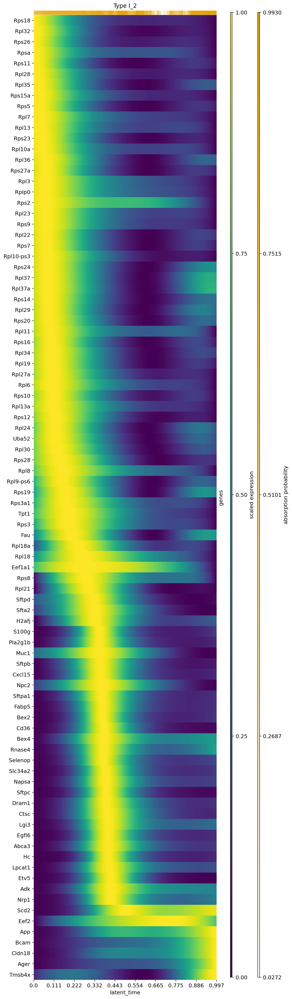

In [61]:
cr.pl.heatmap(adata_w_velo, model, genes=adata_w_velo.var['to Type I_2 corr'].sort_values(ascending=False).index[:90],
              show_absorption_probabilities=True,
              lineages="Type I_2", n_jobs=1, backend='loky',
              figsize=(8,35))

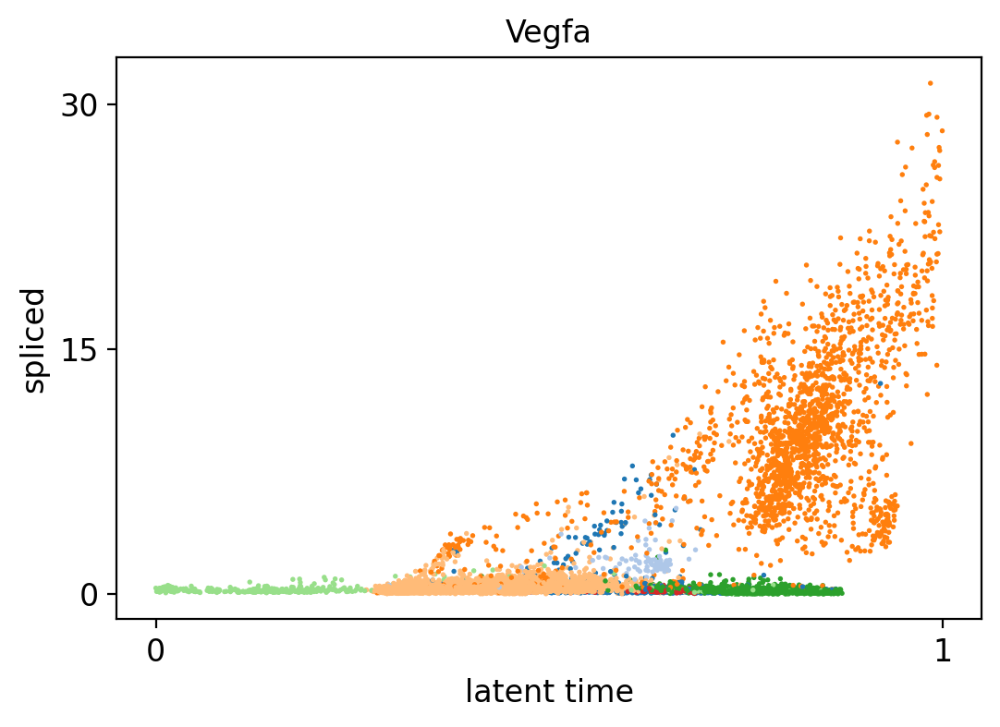

In [62]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Vegfa'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

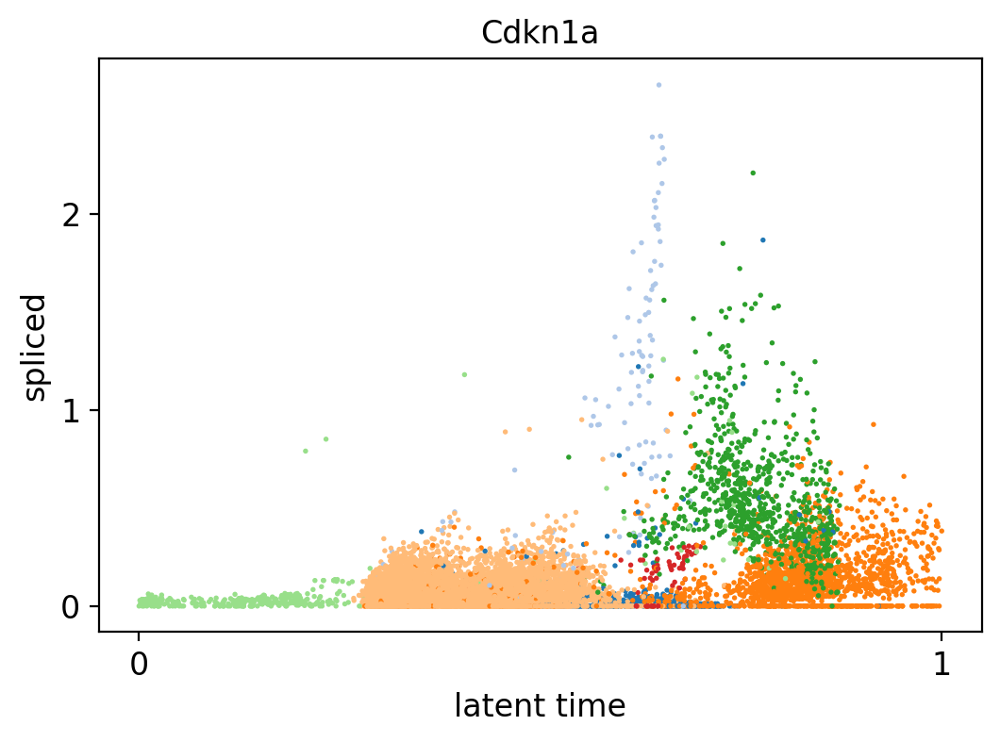

In [63]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Cdkn1a'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

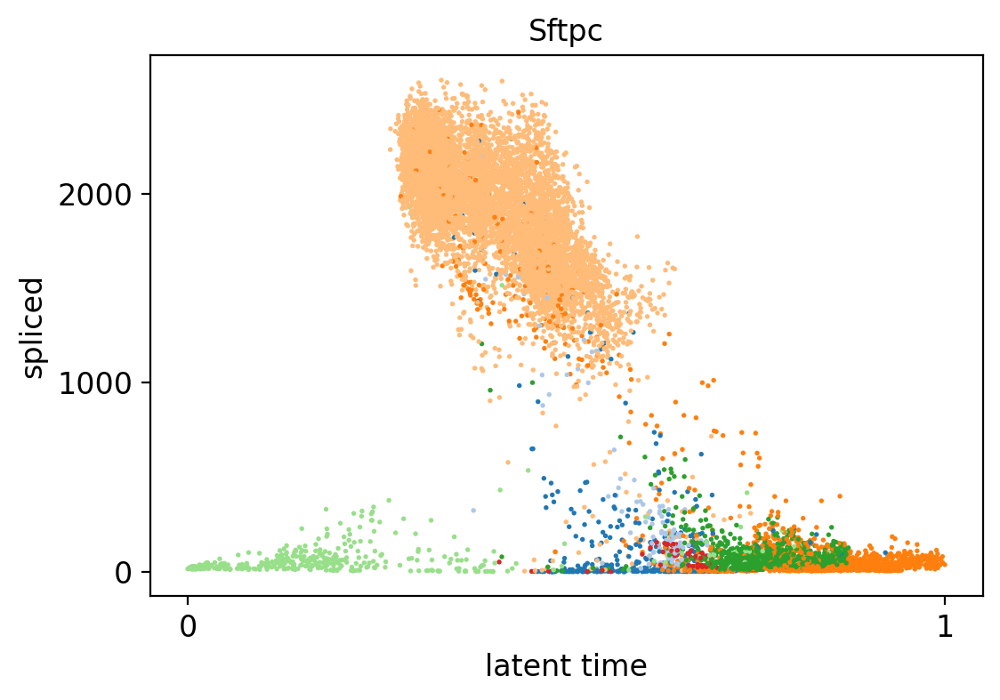

In [64]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Sftpc'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

In [65]:
import scipy.io
from scipy.sparse import csr_matrix
scipy.io.mmwrite('epi_expression_Ms.mtx', csr_matrix(adata_w_velo.layers['Ms']))